In [ ]:
!pip install gtts speechrecognition librosa matplotlib gradio pydub whisper numpy soundfile deep-translator pdf2image pillow


In [36]:
# Import necessary libraries for the TTS-STT project

# Text-to-Speech (TTS) and Speech-to-Text (STT)
from gtts import gTTS  # Google Text-to-Speech
import speech_recognition as sr  # Speech recognition

# Audio Processing
import whisper  # Whisper model for STT
import librosa  # Audio processing and visualization
import librosa.display
import soundfile as sf  # Handling sound files
from pydub import AudioSegment  # Audio file conversion

# Data and Computation
import numpy as np  # Numerical operations
import os  # File system operations

# Display & Visualization
import matplotlib.pyplot as plt  # Plotting audio waveforms
from IPython.display import IFrame, display  # Display elements in Jupyter
import PIL.Image  # Image processing

# PDF Processing (for displaying slides)
from pdf2image import convert_from_path  # Convert PDF slides to images

# Translation (if needed for multilingual TTS/STT)
from deep_translator import GoogleTranslator  # Language translation

# Interactive Web UI
import gradio as gr  # Creating an interactive interface


## Slide 1: Introduction 

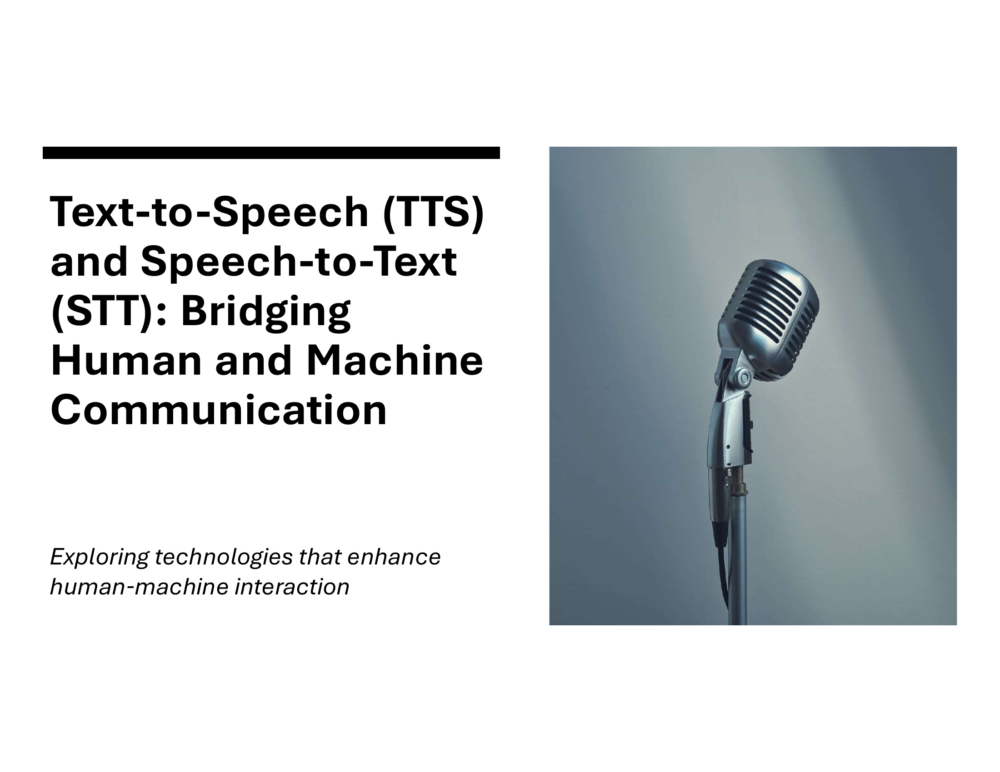

In [2]:

# Convert the first page of the PDF into an image
pdf_path = "TTS-STT Presentations.pdf"
images = convert_from_path(pdf_path, first_page=1, last_page=1)

# Display the first slide as an image
display(images[0])

## Slide 2: What is TTS and STT?

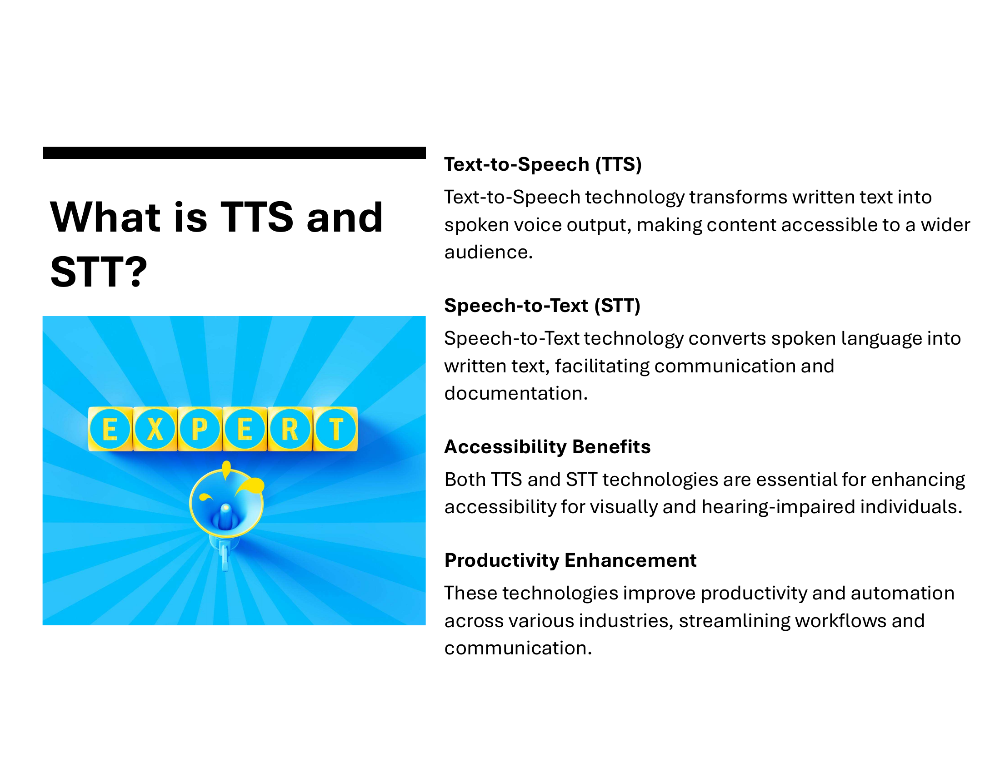

In [3]:
# Convert the second page of the PDF into an image and display it
images = convert_from_path(pdf_path, first_page=2, last_page=2)
display(images[0])


Demonstration: Simple TTS & STT in Action

*   Showcase a simple Text-to-Speech (TTS) conversation.

In [4]:
from gtts import gTTS
import IPython.display as ipd  # Correct import

text = "Welcome to the Text-to-Speech demonstration!"
tts = gTTS(text=text, lang='en')
tts.save("tts_demo.mp3")

# Correct way to play the audio
ipd.Audio("tts_demo.mp3", autoplay=True)


* Speech-to-Text (STT) - Example using my computer microphone

In [6]:
# STT Example - Uncomment to run live recording (requires microphone)
import speech_recognition as sr

recognizer = sr.Recognizer()
mic_index = 2  # Try 2 first, if it doesn't work, try 7 or 11

try:
    with sr.Microphone(device_index=mic_index) as source:
        print(f"Using microphone: {sr.Microphone.list_microphone_names()[mic_index]}")
        print("Say something... (You have 10 seconds)")

        audio = recognizer.listen(source, timeout=5, phrase_time_limit=10)
        print("Processing your voice...")

        text_output = recognizer.recognize_google(audio)
        print("You said:", text_output)

except sr.WaitTimeoutError:
    print("No speech detected within timeout. Try again.")

except sr.UnknownValueError:
    print("Could not understand the audio.")

except sr.RequestError:
    print("Could not request results from Google Speech Recognition.")

except Exception as e:
    print(f"Error: {e}")



Using microphone: Microphone Array (Conexant ISST
Say something... (You have 10 seconds)
Processing your voice...
You said: this is the speech to text demonstration using


## Slide 3: How Does TTS Work?

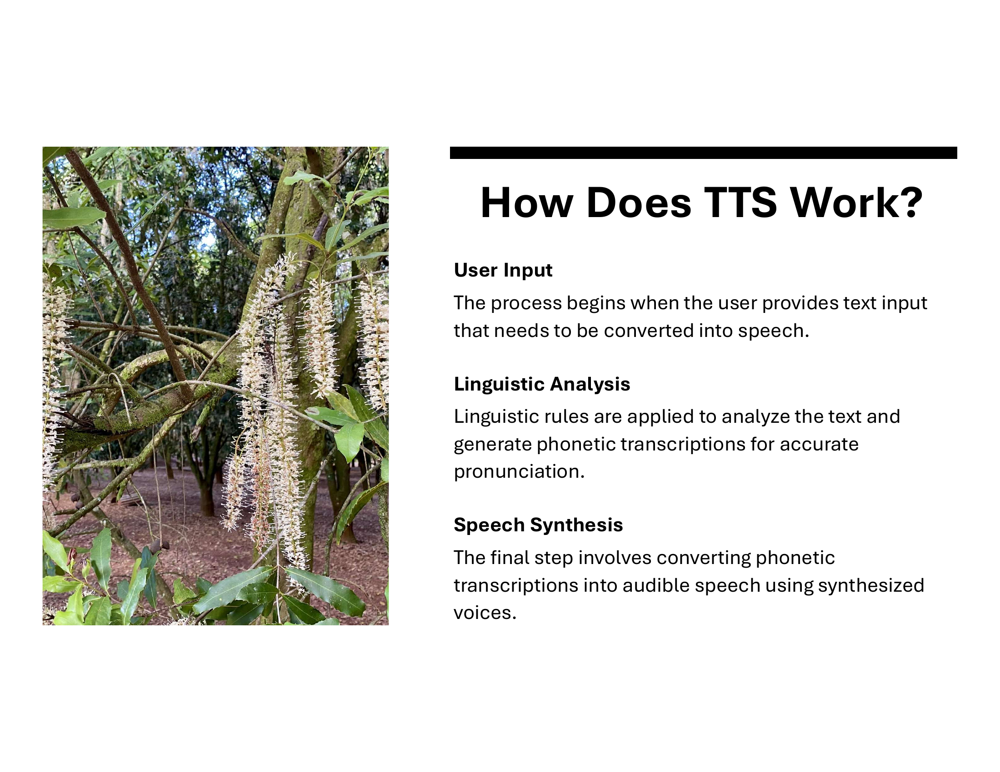

In [7]:
# Convert the third page of the PDF into an image and display it
images = convert_from_path(pdf_path, first_page=3, last_page=3)
display(images[0])


 Demonstration: 
 
 * Convert a sentence into speech using Google TTS


In [8]:
from gtts import gTTS
import IPython.display as display

text = "Welcome to the Text-to-Speech demonstration! I am converting this sentence into speech using Google TTS"
tts = gTTS(text=text, lang='en', slow=False)  # Change slow=True for a slower voice
tts.save("tts_example.mp3")
display.Audio("tts_example.mp3", autoplay=True)


* Experimenting with different voices and speeds

In [9]:
# British Accent
tts_british = gTTS(text=text, lang='en', tld='co.uk')  # British accent
tts_british.save("tts_british.mp3")

print("British Accent:")
display.Audio("tts_british.mp3", autoplay=True)


British Accent:


In [10]:
# Australian Accent
tts_australian = gTTS(text=text, lang='en', tld='com.au')  # Australian accent
tts_australian.save("tts_australian.mp3")

print("Australian Accent:")
display.Audio("tts_australian.mp3", autoplay=True)


Australian Accent:


In [11]:
# Indian Accent
tts_indian = gTTS(text=text, lang='en', tld='co.in')  # Indian accent
tts_indian.save("tts_indian.mp3")

print("Indian Accent:")
display.Audio("tts_indian.mp3", autoplay=True)


Indian Accent:


In [12]:
# Slow Speech
tts_slow = gTTS(text=text, lang='en', slow=True)  # Slow speech
tts_slow.save("tts_slow.mp3")

print("Slow Speech:")
display.Audio("tts_slow.mp3", autoplay=True)


Slow Speech:


Using different languages
* Spanish
* French
* German

In [13]:
tts_spanish = gTTS(text="Hola, bienvenidos a la demostración de síntesis de voz.", lang='es')

tts_spanish.save("tts_spanish.mp3")

print("Spanish Voice:")
display.Audio("tts_spanish.mp3", autoplay=True)


Spanish Voice:


In [14]:
tts_french = gTTS(text="Bonjour et bienvenue dans cette démonstration de synthèse vocale.", lang='fr')

tts_french.save("tts_french.mp3")

print("French Voice:")
display.Audio("tts_french.mp3", autoplay=True)

French Voice:


In [15]:
tts_german = gTTS(text="Hallo und willkommen zur Sprachsynthese-Demonstration.", lang='de')

tts_german.save("tts_german.mp3")

print("German Voice:")
display.Audio("tts_german.mp3", autoplay=True)


German Voice:


## Slide 4: How Does STT Work?


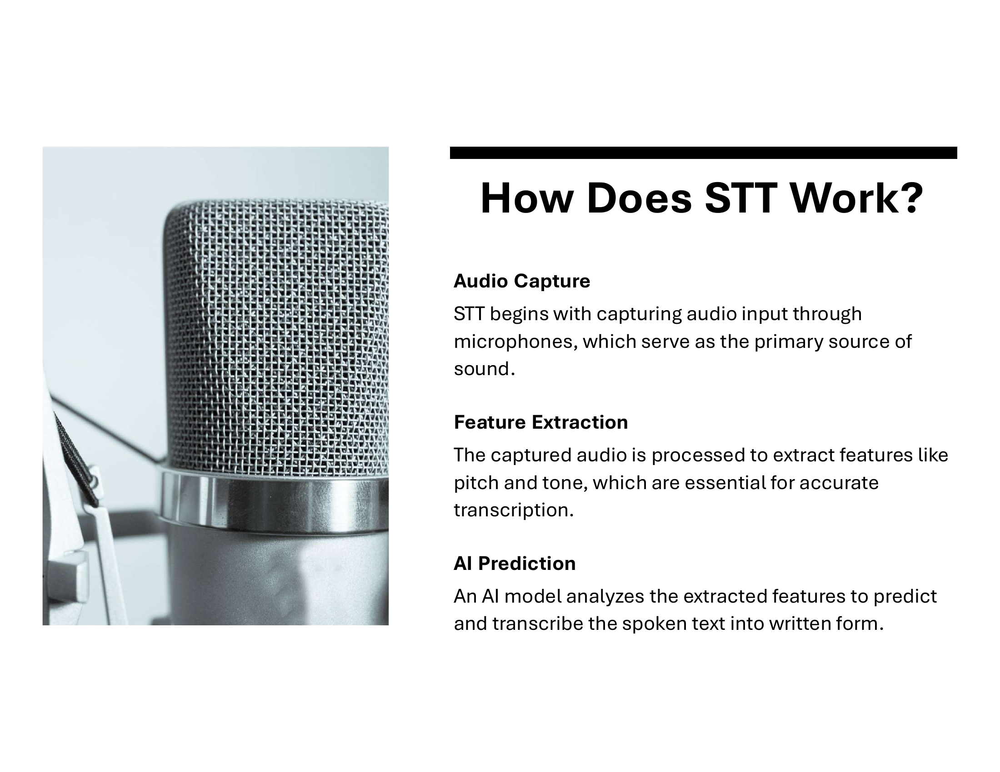

In [18]:
# Convert the third page of the PDF into an image and display it
images = convert_from_path(pdf_path, first_page=4, last_page=4)
display(images[0])


Demonstration: STT Feature Extraction
* Record audio and transcribe it.
* Visualize the waveform & spectogram of an audio file. 

In [19]:
import speech_recognition as sr

# Set the correct microphone index (Check using sr.Microphone.list_microphone_names())
mic_index = 2  # Change if needed (Try 7 or 11 if 2 doesn't work)

recognizer = sr.Recognizer()

with sr.Microphone(device_index=mic_index) as source:
    print(f"Using microphone: {sr.Microphone.list_microphone_names()[mic_index]}")
    print("Say something... (Recording will stop after 5 seconds of silence)")

    try:
        audio = recognizer.listen(source, timeout=5, phrase_time_limit=10)  
        print("Processing your voice...")

        text_output = recognizer.recognize_google(audio)
        print("\nTranscribed Text:", text_output)

    except sr.WaitTimeoutError:
        print("No speech detected within timeout. Try again.")

    except sr.UnknownValueError:
        print("Could not understand the audio.")

    except sr.RequestError:
        print("Could not request results from Google Speech Recognition.")


Using microphone: Microphone Array (Conexant ISST
Say something... (Recording will stop after 5 seconds of silence)
Processing your voice...

Transcribed Text: hello I am going to


Visualize the waveform & spectogram of an audio file

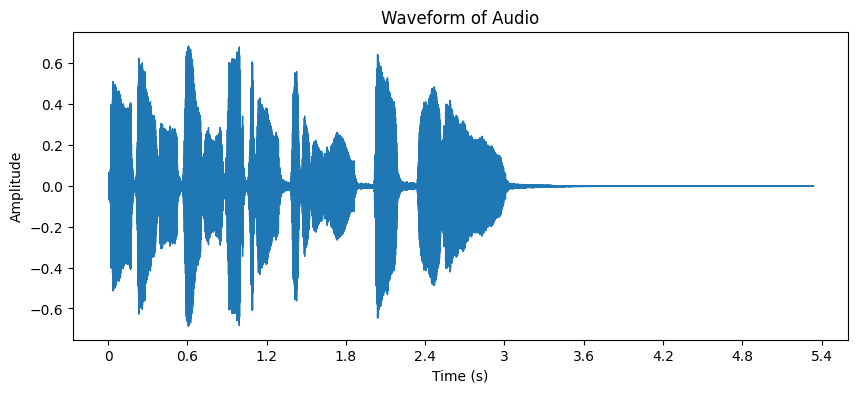

In [20]:
# Load audio file
audio_path = librosa.example('trumpet')
y, sr = librosa.load(audio_path)

# Plot waveform
plt.figure(figsize=(10, 4))
librosa.display.waveshow(y, sr=sr)
plt.title("Waveform of Audio")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.show()

## Slide 5: Real-Life Applications

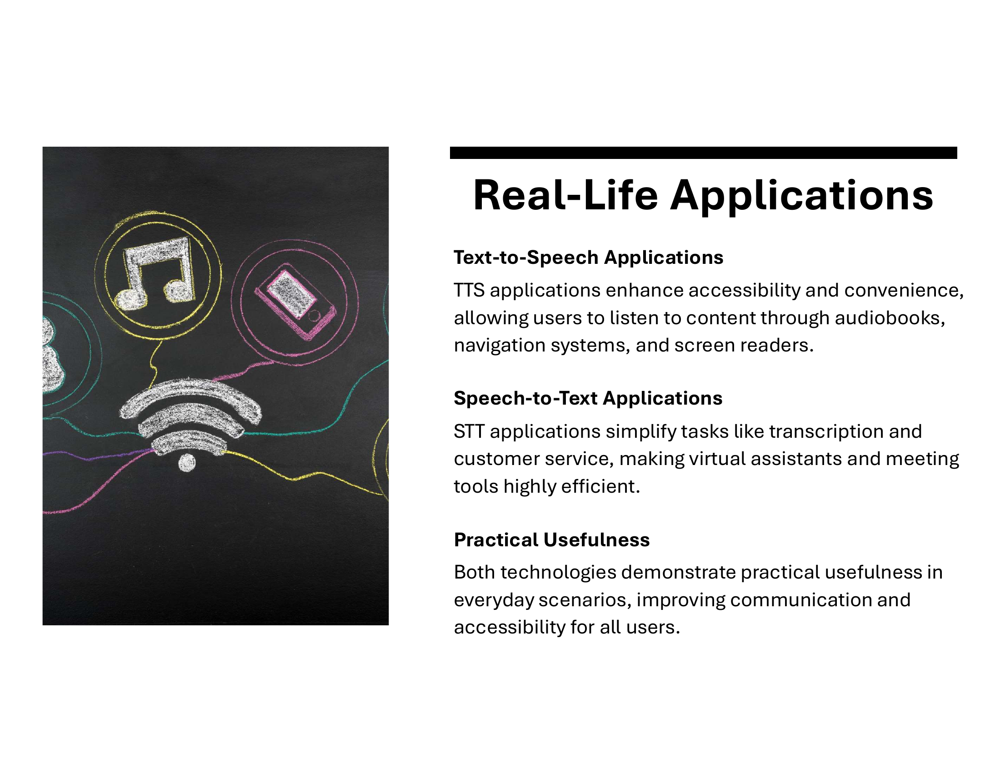

In [21]:
# Convert the fifth page of the PDF into an image and display it
images = convert_from_path(pdf_path, first_page=5, last_page=5)
display(images[0])


## Slide 6: How to Create TTS/STT Solutions


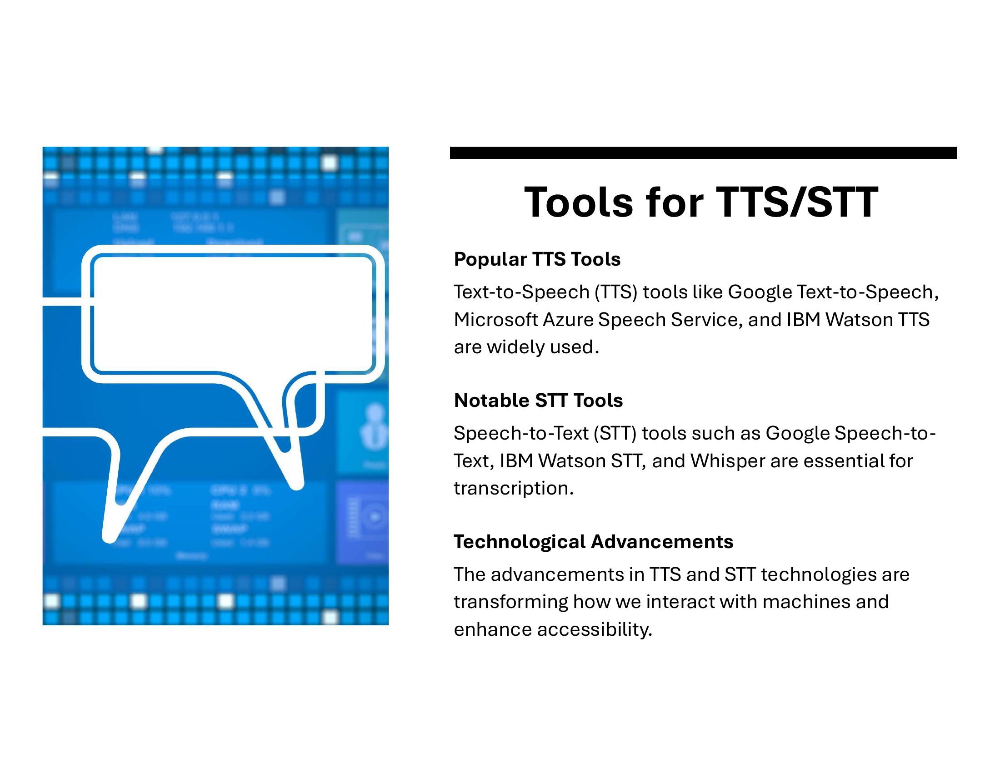

In [22]:
# Convert the sixth page of the PDF into an image and display it
images = convert_from_path(pdf_path, first_page=6, last_page=6)
display(images[0])


Demonstration: Integrating an API (Google Speech-to-Text)


In [24]:
import speech_recognition as sr

def transcribe_google_stt():
    recognizer = sr.Recognizer()
    mic_index = 2  # Change if needed

    with sr.Microphone(device_index=mic_index) as source:
        print(f"Using microphone: {sr.Microphone.list_microphone_names()[mic_index]}")
        print("Recording... Speak now!")

        recognizer.adjust_for_ambient_noise(source, duration=1)  # Reduce background noise
        audio = recognizer.listen(source, timeout=5, phrase_time_limit=30)

    try:
        text = recognizer.recognize_google(audio, language="en-US")  # Use "en-GB" for UK English
        print("\n📝 Transcription:\n", text)

        # Save transcript to a file
        with open("meeting_transcript_google.txt", "w") as file:
            file.write(text)

        return text

    except sr.WaitTimeoutError:
        print("❌ No speech detected. Try again.")
    except sr.UnknownValueError:
        print("❌ Could not understand the audio.")
    except sr.RequestError:
        print("❌ Error connecting to Google Speech-to-Text.")

# Run the transcription function
transcribe_google_stt()


Using microphone: Microphone Array (Conexant ISST
Recording... Speak now!

📝 Transcription:
 this is the Google to text demonstration


'this is the Google to text demonstration'

Real-Time Transcription UI
* Gradio

In [25]:

# Ensure mic_index is correct (use sr.Microphone.list_microphone_names() to verify)
mic_index = 2  # Change if needed after checking available microphones

def transcribe_speech():
    recognizer = sr.Recognizer()
    
    try:
        with sr.Microphone(device_index=mic_index) as source:
            print(f"Using microphone: {sr.Microphone.list_microphone_names()[mic_index]}")
            print("🎤 Say something...")

            recognizer.adjust_for_ambient_noise(source, duration=1)  # Reduce background noise
            audio = recognizer.listen(source, timeout=10, phrase_time_limit=30)  # Capture speech

        # Transcribe speech using Google STT
        text = recognizer.recognize_google(audio, language="en-US")
        return text

    except sr.WaitTimeoutError:
        return "❌ No speech detected. Please try again."
    except sr.UnknownValueError:
        return "❌ Could not understand the audio."
    except sr.RequestError:
        return "❌ Error connecting to Google Speech-to-Text."

# Launch Gradio interface
gr.Interface(
    fn=transcribe_speech, 
    inputs=[], 
    outputs="text", 
    title="🎤 Real-Time Speech Transcription",
    description="Click the button and speak. Your words will be transcribed in real time."
).launch()


* Running on local URL:  http://127.0.0.1:7860

To create a public link, set `share=True` in `launch()`.


Using microphone: Microphone Array (Conexant ISST
🎤 Say something...
Using microphone: Microphone Array (Conexant ISST
🎤 Say something...


Real-Time Transcription UI
* Whisper

In [26]:

mic_index = 2  # Change based on `sr.Microphone.list_microphone_names()`

def record_audio(filename="recorded_audio.wav", duration=10):
    recognizer = sr.Recognizer()

    with sr.Microphone(device_index=mic_index, sample_rate=16000) as source:
        print(f"🎤 Using microphone: {sr.Microphone.list_microphone_names()[mic_index]}")
        print("Recording... Speak now!")

        recognizer.adjust_for_ambient_noise(source, duration=1)
        audio = recognizer.listen(source, timeout=10, phrase_time_limit=duration)

    # Convert audio to WAV using pydub (Fixes slow/distorted recording)
    audio_data = audio.get_wav_data()
    with open(filename, "wb") as f:
        f.write(audio_data)

    print(f"✅ Audio recorded and saved as {filename}")

    return filename

# Test the recording function
audio_file = record_audio()


🎤 Using microphone: Microphone Array (Conexant ISST
Recording... Speak now!
✅ Audio recorded and saved as recorded_audio.wav


In [28]:
from IPython.display import Audio, display

print("Recorded Audio")
display(Audio("recorded_audio.wav", autoplay=True))


Recorded Audio


In [29]:
import whisper

# Load Whisper model
model = whisper.load_model("base")

# Transcribe the corrected audio file
print("⏳ Transcribing audio with Whisper...")
result = model.transcribe("recorded_audio.wav")

# Extract transcript
transcript = result["text"]
print("\n📝 Transcribed Text:\n", transcript)

# Save transcript
with open("transcript_whisper.txt", "w") as f:
    f.write(transcript)

print("✅ Transcription saved as transcript_whisper.txt")


c:\Users\kalop\AppData\Local\Programs\Python\Python312\Lib\site-packages\whisper\__init__.py:150: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(fp, m

⏳ Transcribing audio with Whisper...


c:\Users\kalop\AppData\Local\Programs\Python\Python312\Lib\site-packages\whisper\transcribe.py:126: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")



📝 Transcribed Text:
  This is the demonstration using the wrist.
✅ Transcription saved as transcript_whisper.txt


Whisper API for real-world transcriptions

In [30]:

# Set the YouTube video URL (replace with any short video URL)
youtube_url = "https://www.youtube.com/watch?v=JzPfMbG1vrE"  # Example: 30-second explainer video

# Define output filename (without .mp3 extension)
output_file = "youtube_audio"

# Download the audio file (MP3 format)
os.system(f'yt-dlp -x --audio-format mp3 --output "{output_file}.mp3" {youtube_url}')

print(f"✅ Download complete: {output_file}.mp3")


✅ Download complete: youtube_audio.mp3


In [31]:
# Converts MP3 to WAV (Required for Whisper)

os.system('ffmpeg -i youtube_audio.mp3 -ar 16000 -ac 1 -c:a pcm_s16le youtube_audio.wav')
print("✅ Conversion complete: youtube_audio.wav")


✅ Conversion complete: youtube_audio.wav


In [32]:

# Load the Whisper model
model = whisper.load_model("base")  # Use "small", "medium", or "large" for better accuracy

# Transcribe the downloaded audio file
print("⏳ Transcribing YouTube audio with Whisper...")
result = model.transcribe("youtube_audio.wav")

# Extract only the transcript text
transcript = result["text"]
print("\n📝 Transcribed Text:\n", transcript)

# Save transcript to a file
with open("youtube_transcript.txt", "w") as f:
    f.write(transcript)

print("✅ Transcription saved as youtube_transcript.txt")


⏳ Transcribing YouTube audio with Whisper...

📝 Transcribed Text:
  So you're running a little late today. And you haven't had your fresh cup of coffee yet. No matter the weather or traffic, we deliver fresh coffee and bagels. The Java Cap Bag
✅ Transcription saved as youtube_transcript.txt


## Slide 7: How to Create TTS/STT Solutions

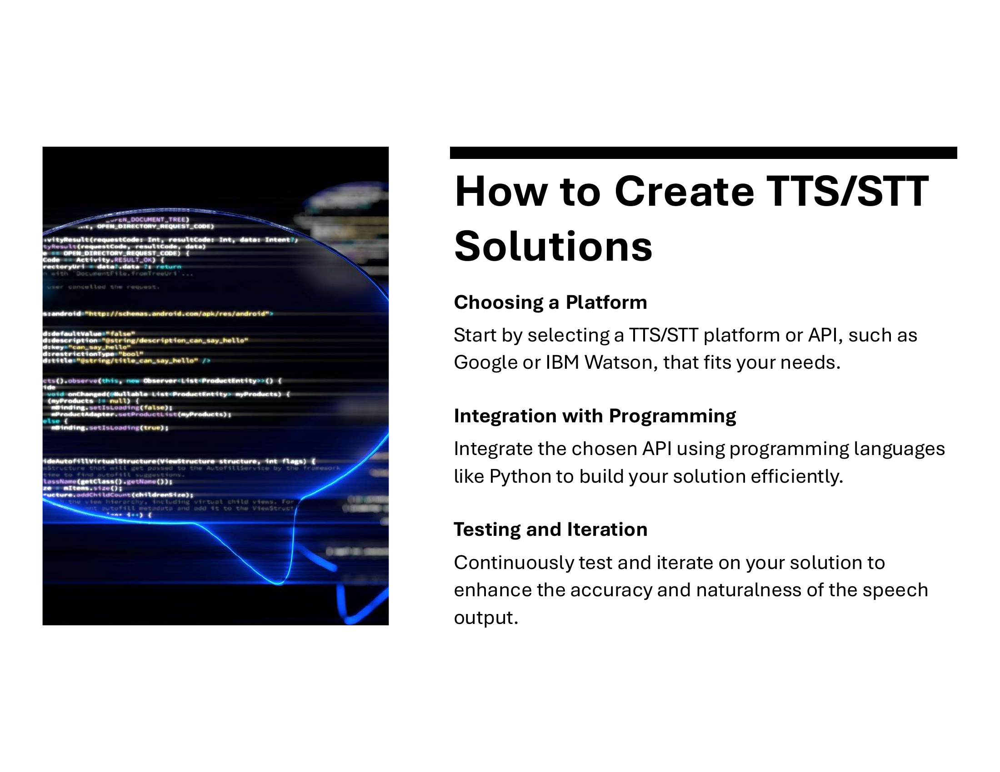

In [33]:
# Convert the seventh page of the PDF into an image and display it
images = convert_from_path(pdf_path, first_page=7, last_page=7)
display(images[0])


## Slide 8: Benefits and Challenges


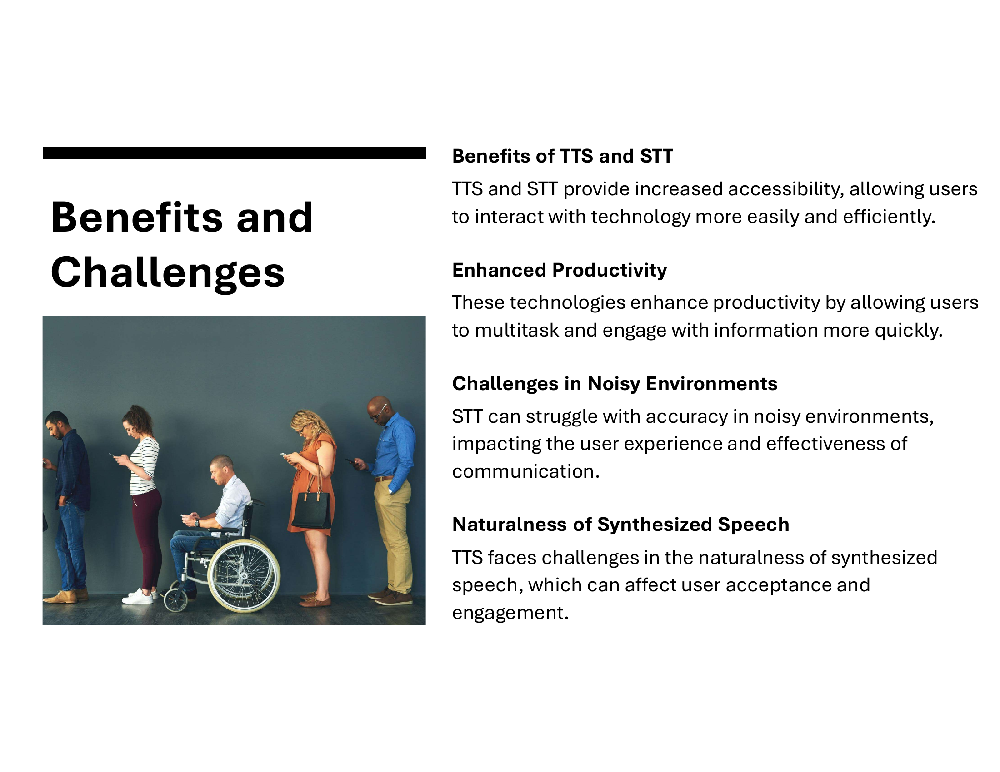

In [34]:
# Convert the seventh page of the PDF into an image and display it
images = convert_from_path(pdf_path, first_page=8, last_page=8)
display(images[0])


Demonstration: Noise Impact on STT
* Add artificial noise to audio and compare STT results before and after noise addition.

In [38]:
import numpy as np
import soundfile as sf
from IPython.display import Audio, display  # Import Audio properly

# Define filenames
clean_audio_file = "youtube_audio.wav"  # Ensure this file exists
noisy_audio_file = "youtube_audio_noisy.wav"

# Load the clean audio file
y, sr = sf.read(clean_audio_file)

# Add artificial white noise
noise = np.random.normal(0, 0.02, y.shape)  # Adjust noise level (0.02 works well)
y_noisy = y + noise

# Save the noisy audio file
sf.write(noisy_audio_file, y_noisy, sr)
print(f"✅ Noisy audio saved as {noisy_audio_file}")

# Play the original and noisy audio
print("🔊 Original Audio:")
display(Audio(clean_audio_file, autoplay=True))  # Fix: Correctly call `Audio`

print("🔊 Noisy Audio:")
display(Audio(noisy_audio_file, autoplay=True))  # Fix: Correctly call `Audio`


✅ Noisy audio saved as youtube_audio_noisy.wav
🔊 Original Audio:


🔊 Noisy Audio:


In [39]:
# Compare Transcriptions
def transcribe_audio(filename):
    model = whisper.load_model("base")  # Load Whisper model

    print(f"⏳ Transcribing {filename}...")
    result = model.transcribe(filename)

    return result["text"]

# Transcribe clean and noisy audio
clean_transcription = transcribe_audio(clean_audio_file)
noisy_transcription = transcribe_audio(noisy_audio_file)

# Compare transcriptions
print("\n🎤 Clean Audio Transcription:\n", clean_transcription)
print("\n🔊 Noisy Audio Transcription:\n", noisy_transcription)

# Save results to a text file (Fix for Unicode Encoding Error)
with open("transcription_comparison.txt", "w", encoding="utf-8") as f:
    f.write("🎤 Clean Audio Transcription:\n" + clean_transcription + "\n\n")
    f.write("🔊 Noisy Audio Transcription:\n" + noisy_transcription + "\n")

print("✅ Transcription comparison saved as transcription_comparison.txt")


⏳ Transcribing youtube_audio.wav...
⏳ Transcribing youtube_audio_noisy.wav...

🎤 Clean Audio Transcription:
  So you're running a little late today. And you haven't had your fresh cup of coffee yet. No matter the weather or traffic, we deliver fresh coffee and bagels. The Java Cap Bag

🔊 Noisy Audio Transcription:
  So you're running a little late today. And you haven't had your fresh cup of coffee yet. No matter the weather or traffic, we deliver fresh coffee and bagels. The Java Cap Bag.
✅ Transcription comparison saved as transcription_comparison.txt


## Slide 9: Future of TTS & STT


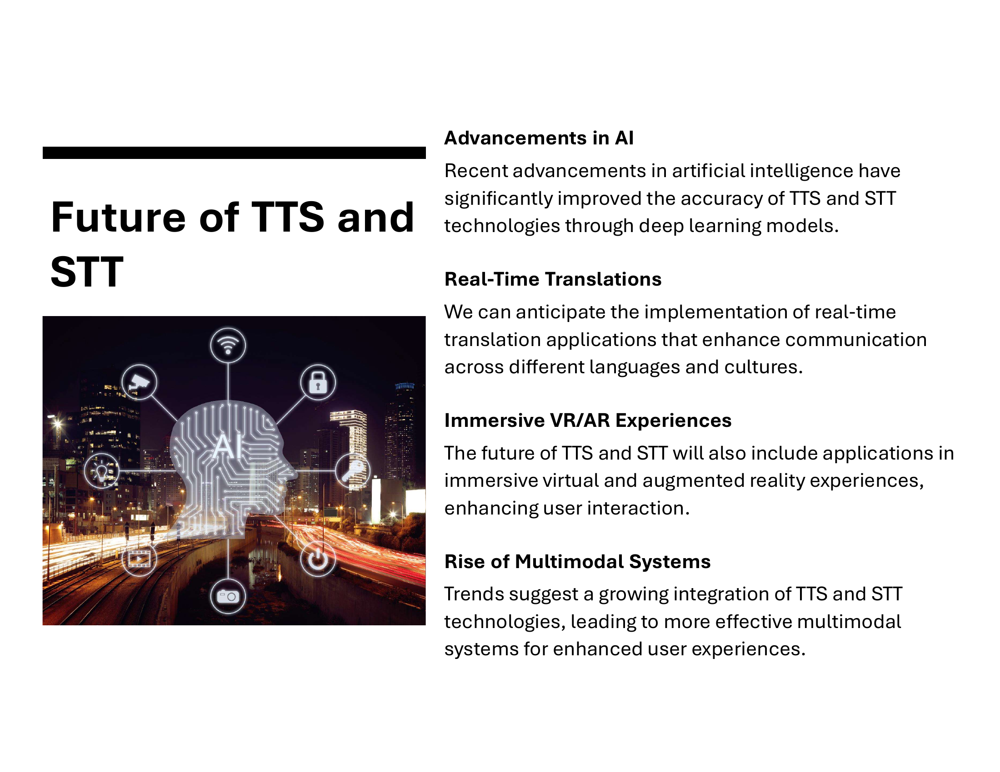

In [40]:
# Convert the seventh page of the PDF into an image and display it
images = convert_from_path(pdf_path, first_page=9, last_page=9)
display(images[0])


Demonstration: Real-Time Speech Translation
* Convert speech to text - Translate it using Google Translate API - Convert back to speech.

In [41]:
from deep_translator import GoogleTranslator

# Example translation
text_to_translate = "Hello, how are you?"
translated_text = GoogleTranslator(source='en', target='es').translate(text_to_translate)

print("Original:", text_to_translate)
print("Translated:", translated_text)


Original: Hello, how are you?
Translated: ¿Hola, cómo estás?


## Additional Interactive Demonstration: Gradio UI

In [42]:

def tts_function(text):
    tts = gTTS(text=text, lang='en')
    tts.save("tts_output.mp3")
    return "tts_output.mp3"

gr.Interface(tts_function, "text", "audio").launch()


* Running on local URL:  http://127.0.0.1:7861

To create a public link, set `share=True` in `launch()`.


## Slide 9: Future of TTS and STT

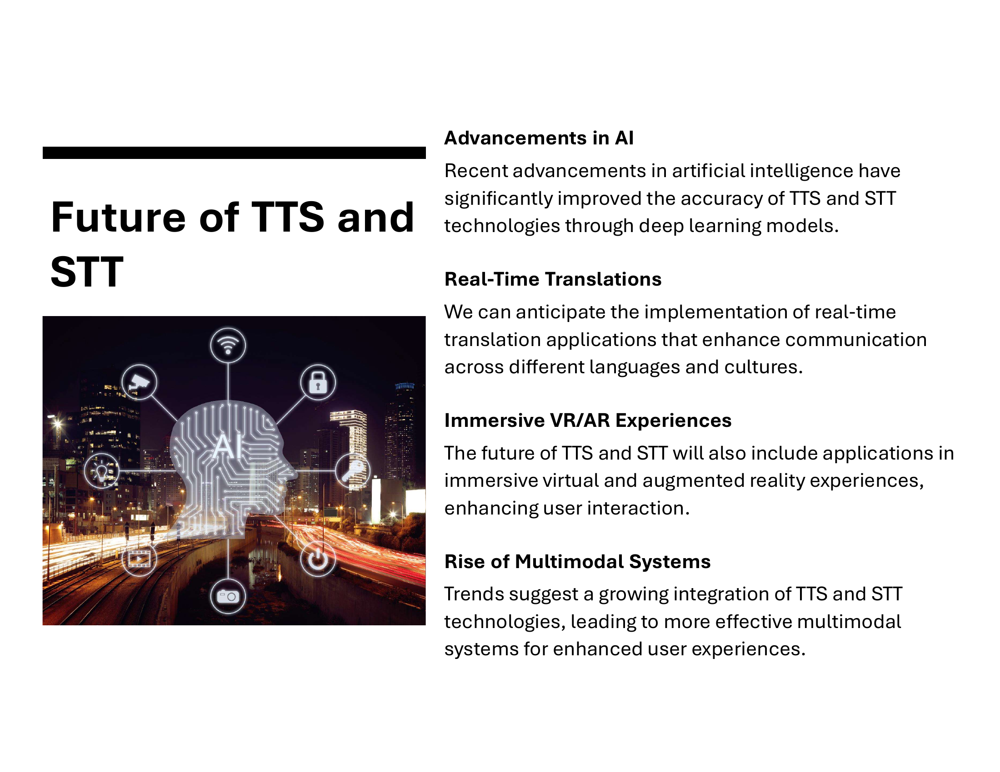

In [43]:
# Convert the seventh page of the PDF into an image and display it
images = convert_from_path(pdf_path, first_page=9, last_page=9)
display(images[0])


## Slide 10: Discussion and Q & A

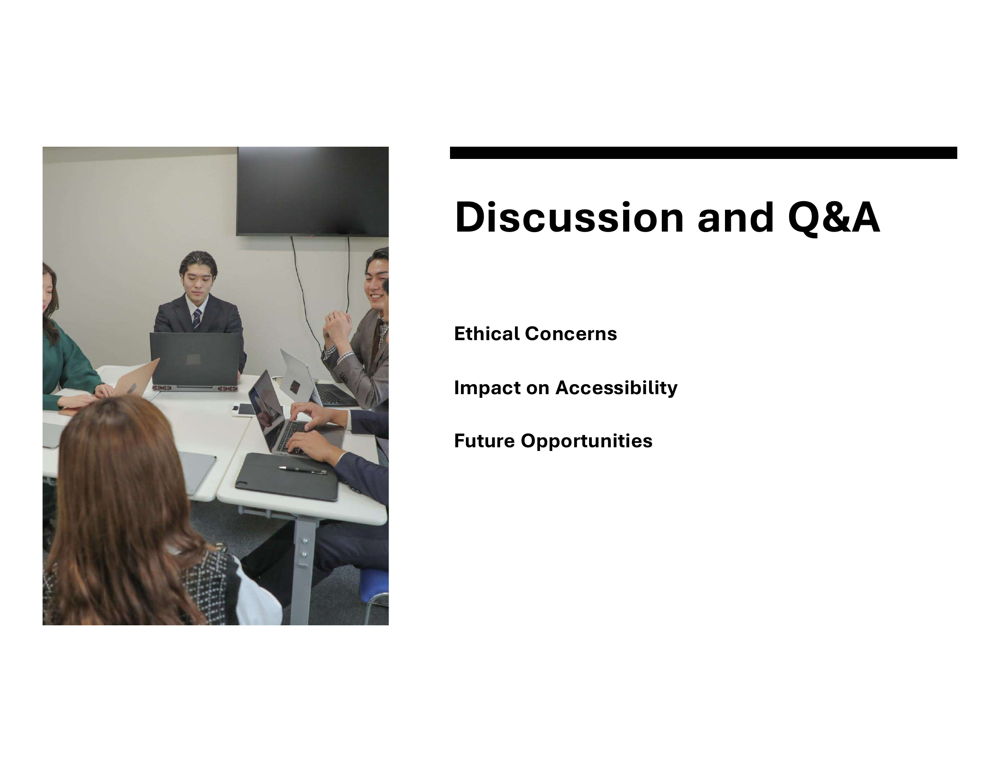

In [45]:
# Convert the seventh page of the PDF into an image and display it
images = convert_from_path(pdf_path, first_page=10, last_page=10)
display(images[0])


## Slide 11: Conclusion

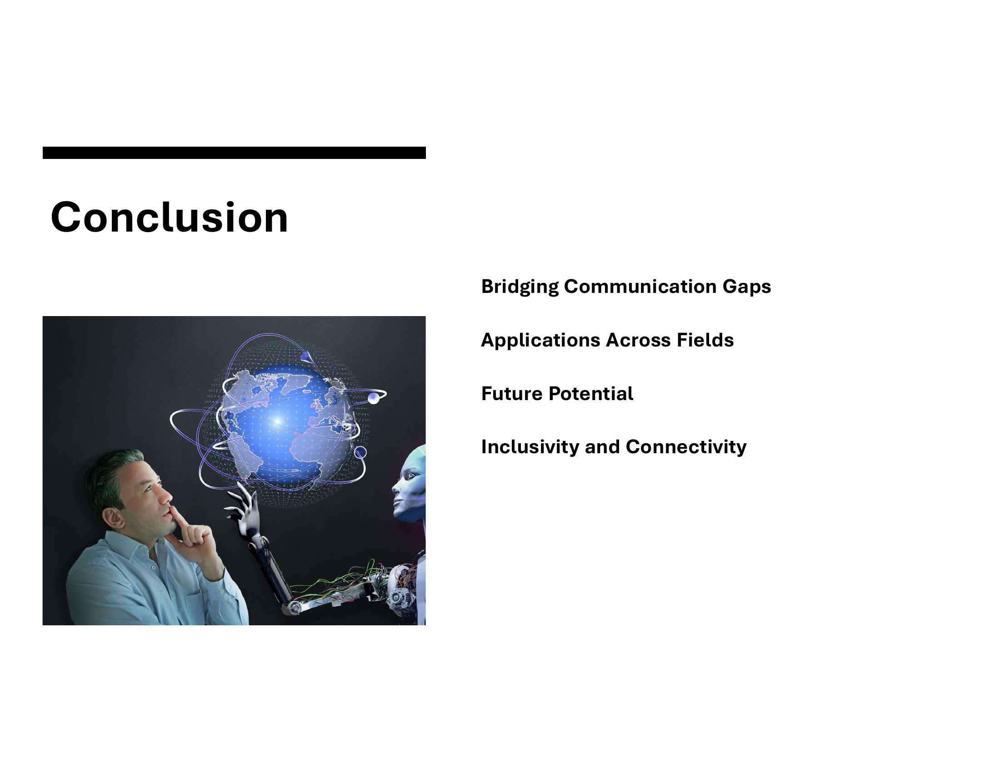

In [46]:
# Convert the seventh page of the PDF into an image and display it
images = convert_from_path(pdf_path, first_page=11, last_page=11)
display(images[0])
